# Supervised or unsupervised & model types

````{margin}
```{warning}
These pages are currently under construction and will be updated continuously.
Please visit these pages again in the next few weeks for further information.
````

---------------

## Aim(s) of this section 🎯

- learn about the distinction between supervised & unsupervised machine learning 
- get to know the variety of potential models within each

## Outline for this section 📝

1. supervised vs. unsupervised learning
2. supervised learning examples
3. unsupervised learning examples

## A brief recap & first overview


<img align="right" src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/AI_ML.png" alt="logo" title="Github" width="320" height="120" />

**Machine learning (ML)** is the study of computer [algorithms](https://en.wikipedia.org/wiki/Algorithm) that can improve automatically through experience and by the use of data. It is seen as a part of [artificial intelligence](https://en.wikipedia.org/wiki/Artificial_intelligence). Machine learning algorithms build a model based on sample data, known as ["training data"](https://en.wikipedia.org/wiki/Training_data), in order to make predictions or decisions without being explicitly programmed to do so. A subset of machine learning is closely related to [computational statistics](https://en.wikipedia.org/wiki/Computational_statistics), which focuses on making predictions using computers; but not all machine learning is statistical learning. The study of [mathematical optimization](https://en.wikipedia.org/wiki/Mathematical_optimization) delivers methods, theory and application domains to the field of machine learning. [Data mining](https://en.wikipedia.org/wiki/Data_mining) is a related field of study, focusing on [exploratory data analysis](https://en.wikipedia.org/wiki/Exploratory_data_analysis) through [unsupervised learning](https://en.wikipedia.org/wiki/Unsupervised_learning). Some implementations of machine learning use data and [neural networks](https://en.wikipedia.org/wiki/Neural_networks) in a way that mimics the working of a biological brain.

[https://en.wikipedia.org/wiki/Machine_learning](https://en.wikipedia.org/wiki/Machine_learning)


Let’s bring back our simplified graphical description that we introduced in the previous section:

<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/core_aspects_examples.png" alt="logo" title="Github" width="600" height="340" /></center>

So far we talked about how a `model` (`M`) can be utilized to obtain information (`output`) from a certain `input`.

The information requested can be manifold but roughly be situated on two broad levels:

- [learning problem](https://en.wikipedia.org/wiki/Machine_learning#Approaches)
        - [supervised](https://en.wikipedia.org/wiki/Supervised_learning) or [unsupervised](https://en.wikipedia.org/wiki/Unsupervised_learning)

- specific task type
        - predicting clinical measures, behavior, demographics, other properties
        - segmentation
        - discover hidden structures
        - etc.

Lucky for us, the `scikit-learn` docs entail an amazing graphic outlining different `model` types that can be of tremendous help when deciding on a given analysis pipeline:

<center><img src="https://scikit-learn.org/stable/_static/ml_map.png" alt="logo" title="Github" width="1000" height="550" /></center>

<sub><sup><sub><sup><sup>https://scikit-learn.org/stable/_static/ml_map.png
</sup></sup></sub></sup></sub>

Here, we are going to add a bit more content to further stress the distinctions made above. First, the `learning problem`:

<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/sklearn_map_learning_problem.png" alt="logo" title="Github" width="1000" height="550" /></center>


<sub><sup><sub><sup><sup>https://scikit-learn.org/stable/_static/ml_map.png
</sup></sup></sub></sup></sub>

And second, the `task type`:

<center><img align="center" src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/sklearn_map_task_type.png" alt="logo" title="Github" width="1000" height="550" /></center>


<sub><sup><sub><sup><sup>https://scikit-learn.org/stable/_static/ml_map.png
</sup></sup></sub></sup></sub>

## Learning problems - supervised vs. unsupervised

Based on these aspects we can and need to further specify our graphical description:

<br>

<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/supervised_unsupervised.png" alt="logo" title="Github" width="1200" height="350" /></center>

If we now also include `task type` we can basically describe things via a `2 x 2 design` (leaving our graphical description for a moment):

<br>

<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/learning_problems_task_types.png" alt="logo" title="Github" width="1200" height="350" /></center>

## Some primers using the example dataset

Now that we've gone through a huge set of definitions and road maps, let's go away from this rather abstract discussions to the "real deal".
Specifically, how these `models` behave in the wild. For this we're going to sing the song "hello example dataset my old friend, I came to apply machine learning to you again.". Just to be sure: we will use the example dataset we briefly explored in the [previous section]() again to showcase how these `models` can be put into action, how they change/affect the questions one's asking, and how to interpret the results.

At first, we're going to `load` our `input` `data`, i.e., `X` again:

In [1]:
import numpy as np

data = np.load('MAIN2019_BASC064_subsamp_features.npz')['a']
data.shape

(155, 2016)

Just as a reminder: what we have in `X` here is a `vectorized connectivity matrix` containing `2016` `features`, which constitutes the correlation between brain region-specific time courses for each of `155` `samples` (`participants`).

As before, we can visualize our `X` to inspect it and maybe get a first idea if there might be something going on (please click on the `+` to see the `code`):

In [2]:
import plotly.express as px
from IPython.core.display import display, HTML
from plotly.offline import init_notebook_mode, plot

fig = px.imshow(data, labels=dict(x="features", y="participants"), height=800, aspect='None')

fig.update(layout_coloraxis_showscale=False)
init_notebook_mode(connected=True)

#fig.show()

plot(fig, filename = '../../../static/input_data.html')
display(HTML('../../../static/input_data.html'))

At this point we already need to decide on our `learning problem`:  
- do we want to use the information we already have (`labels`) and thus conduct a `supervised learning` analysis to predict `Y`?  
- do we want to find information we do not have (yet) and thus conduct an `unsupervised learning` analysis to e.g., find `clusters` in the `data`?

```{note}
**Please note**: we only do this for the sake of this course! Please never do this type of "Hm, maybe we do this or this, let's see how it goes." approach in your research. Always make sure you have a precise analyses plan that is informed by prior research and guided by the possibilities of your data. Otherwise you'll just add to the ongoing reproducibility and credibility crisis, not accelerating but hindering scientific progress.

However, there is always room for exploratory analyses, just be honest about it and don't acting as if they are confirmatory.
```

That being said: we're going to basically test of all them (talking about "to not practise what one preaches", eh?), again, solely for teaching purposes. 

Within a given `learning problem`, we will go through a couple of the most heavily used `estimators`/`algorithms` and give a little bit of information about each
    - supervised learning: [SVM](https://en.wikipedia.org/wiki/Support-vector_machine), [regression](https://en.wikipedia.org/wiki/Regression_analysis),  [nearest neighbor](https://en.wikipedia.org/wiki/Nearest_neighbor_search), [tree-ensembles](https://en.wikipedia.org/wiki/Ensemble_learning)
    - unsupervised learning: [PCA](https://en.wikipedia.org/wiki/Principal_component_analysis), [kmeans](https://en.wikipedia.org/wiki/K-means_clustering), [hierarchical clustering](https://en.wikipedia.org/wiki/Hierarchical_clustering)

We're going to start with `supervised learning`, thus using the information we already have.

## Supervised learning

Independent of the precise `task type` we want to run, we initially need to load the information, i.e. `labels`, available to us:

In [3]:
import pandas as pd
information = pd.read_csv('participants.csv')
information.head(n=5)

,participant_id,Age,AgeGroup,Child_Adult,Gender,Handedness
0,sub-pixar123,27.06,Adult,adult,F,R
1,sub-pixar124,33.44,Adult,adult,M,R
2,sub-pixar125,31.00,Adult,adult,M,R
3,sub-pixar126,19.00,Adult,adult,F,R
4,sub-pixar127,23.00,Adult,adult,F,R


As you can see, we have multiple variables, this is where we get the `labels` from, that allow us to describe our participants (i.e., `samples`).

Almost each of these variables can be used to address a `supervised learning` problem (e.g., `Child_Adult` variable).


What's the goal here again? Let's bring back our graphical description:

<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/core_aspects_examples.png" alt="logo" title="Github" width="600" height="380" /></center>

Overall, goal 🎯 is to learn `parameters` (or `weights`) of a `model` (`M`) that maps `X` to `y`. 

Based on the information available to us, we see a few things:

- Some are variables are `categorical` and thus could be employed within a `classification` analysis (e.g., `children` vs. `adults`).
- Some are `continuous` and thus would fit within a `regression` analysis (e.g., `Age`).


We're going to explore both!

### Supervised learning - classification

<br>
<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/core_aspects_examples.png" alt="logo" title="Github" width="600" height="380" /></center>

- goal: Learn parameters (or weights) of a model (`M`) that maps `X` to `y` 

In order to run a `classification` analysis, we need to obtain the correct `categorical labels` defining them as our `Y`

In [4]:
Y_cat = information['Child_Adult']
Y_cat.describe()

count       155
unique        2
top       child
freq        122
Name: Child_Adult, dtype: object

We can see that we have two `unique` expressions, but let's plot the `distribution` just to be sure and maybe see something important/interesting (please click on the `+` to see the `code`):

In [5]:
fig = px.histogram(Y_cat, marginal='box', template='plotly_white')

fig.update_layout(showlegend=False, width=800, height=800)
init_notebook_mode(connected=True)
#fig.show()

plot(fig, filename = '../../../static/labels.html')
display(HTML('../../../static/labels.html'))

That looked about right and we can continue with our analysis.

To keep things easy, we will use the same pipeline we employed in the [previous section](), that is we will [scale]() our `input` `data`, `train` a [Support Vector Machine]() and `test` its [predictive performance](). At first, we import the necessary `python` `modules`:

In [6]:
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

And then setup the `pipeline`, defining `preprocessing` and the `estimator`: 

In [7]:
# set up pipeline (sequence of steps)
pipe = make_pipeline(
    # Step 1: z-score (z = (x - u) / s) 
    # the features (i.e., predictors)
    StandardScaler(),
    # Step 2: run classification using a 
    # Support Vector Classifier
    SVC()
)

However, before we actually run things, we should start talking about the `estimator`(s) we're using in more detail.

#### A bit of information on [Support Vector Machines](https://en.wikipedia.org/wiki/Support-vector_machine):

`Support vector machines` or `SVM`s for short comprise a set of `non-probabilistic binary supervised learning methods` which means that they predict discrete `labels` for each `sample` for `one` of `two` `classes`. 

However, one can also tackle so called "`multi-class problems`" within which `labels` for more than two `classes` will/can be `predicted`. In these cases, `SVM`s classically implement either `one-vs-one` or `one-vs-rest` strategies and thus either run `pair-wise problems` for all possible `pairs` of `labels` and then aggregate the result into one overarching `performance` or formulate `learning problems` in which `one label` is put against an aggregated version of all other `labels` and the respective outcomes again being combined to obtain one overarching `performance`.   

In short, `SVM`s utilize [hyperplane(s)](https://en.wikipedia.org/wiki/Hyperplane) as decision boundaries. A `hyperplane` (in terms of geometry) is a subspace that has one dimension less than the space it operates in, ie the [ambient space](https://en.wikipedia.org/wiki/Ambient_space). Applied to `artificial intelligence`, here `machine learning` and specifically `SVM`s, the `ambient space` is defined by the number of `features` and the `hyperplane` aims to separate the `data` into different `classes` and is defined by `n_feature dimensions - 1`. Thus, it acts as a `decision boundary` as mentioned before. 


The `data points` that are very close to the `decision boundary` are crucial to the `SVM` and its `optimization`/`performance`. They are thus called the `support vectors`. In order to find the best `hyperplane`, the distance should to the `support vectors` should be maximized. This distance is referred to as `margin` and are described via terms like e.g. `small` and `large`.

<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/svc.png" alt="logo" title="Github" width="500" height="450" /></center>

So far it might appear that `SVM`s are only applicable for `classification problems` where data is `linearly separable`. However, that's not the case at all: while routinely used for such applications, `SVM`s can also perform `regression` (`support vector regression` or `SVR`) and `non-linear classification` via the so-called [kernel trick](https://en.wikipedia.org/wiki/Kernel_method#Mathematics:_the_kernel_trick), employing a `non-linear kernel`. We will see what this means in a bit. For now, lets check an example.

#### General example

Using an [example dataset from scikit-learn](), we will showcase and explain important aspects of `SVM`s further (please click on the `+` to see the `code`). 

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import svm
from sklearn.datasets import make_blobs

# *** just for demostrastion purposes ***
# we create 40 separable points
X, y = make_blobs(n_samples=40, centers=2, random_state=6)

# fit the model, don't regularize for illustration purposes
clf = svm.SVC(kernel='linear', C=1000)
clf.fit(X, y)

# get feature limits
xlim = (X[:, 0].min(), X[:, 0].max())
ylim = (X[:, 1].min(), X[:, 1].max())

# create grid to evaluate model
xx = np.linspace(xlim[0], xlim[1], 30)
yy = np.linspace(ylim[0], ylim[1], 30)
YY, XX = np.meshgrid(yy, xx)
xy = np.vstack([XX.ravel(), YY.ravel()]).T
Z = clf.decision_function(xy).reshape(XX.shape)

In [4]:
# generate plotly figure
import plotly.graph_objects as go
from plotly.offline import plot
from IPython.core.display import display, HTML

colorscale = [[0, 'gray'], [0.5, 'black'], [1, 'gray']]

fig = go.Figure()
fig.add_trace(
    go.Contour(
        z=Z.T,
        x=np.linspace(X[:, 0].min(), X[:, 0].max(), 30),
        y=np.linspace(X[:, 1].min(), X[:, 1].max(), 30),
        colorscale=colorscale,
        contours_coloring='lines',
        contours=dict(start=-1, end=1, size=1),
        line=dict(dash='dash',width=2),
        name='Desicion Function',
        showscale=False
    )
)
# add elements
fig.add_trace(go.Scatter(x=X[y==0, 0], y=X[y==0, 1], 
                         mode='markers', 
                         marker=dict(color='crimson', size=10),
                         name='1'))
fig.add_trace(go.Scatter(x=X[y==1, 0], y=X[y==1, 1],
                         mode='markers', 
                         marker=dict(color='darkblue', size=10),
                         name='2'))
fig.add_trace(go.Scatter(x=clf.support_vectors_[:, 0], 
                         y=clf.support_vectors_[:, 1], 
                         marker=dict(color='white', size=7),
                         mode='markers', name=''))

fig.add_annotation(xref="x domain", yref="y", x=0.1, y=-5.2,
                   text="optimal <br> (hyperplane)",
                   showarrow=True, arrowhead=2, arrowsize=2,
                   axref="x domain", ayref="y", ax=0.2, ay=-1)
fig.add_annotation(xref="x domain", yref="y", x=0.1, y=-6.25,
                   text="maximal <br> (margin)",
                   showarrow=True, arrowhead=2, arrowsize=2,
                   axref="x domain", ayref="y", ax=0.1, ay=-10)
fig.add_annotation(xref="x domain", yref="y", x=0.58, y=-7.6,
                   text="support vectors",
                   showarrow=True, arrowhead=2, arrowsize=2,
                   axref="x domain", ayref="y", ax=0.75, ay=-9)
fig.add_annotation(xref="x domain", yref="y", x=0.5, y=-4.8,
                   text="support vectors",
                   showarrow=True, arrowhead=2, arrowsize=2, 
                   axref="x domain", ayref="y",
                   ax=0.75, ay=-9)
# set figure size and margins
fig.update_layout(
    autosize=False,
    width=800, height=500,
    margin=dict(l=50, r=200, b=100, t=100, pad=10),
    title="Decision Function",
    xaxis_title="Feature 1",
    yaxis_title="Feature 2",
    legend_title="Classes",
    font=dict(size=18, color="Black"),
    template='plotly_white'
)
# fig.show()

# display figure
plot(fig, filename = '../../../static/SVC.html')
display(HTML('../../../static/SVC.html'))

What does the `SVM` tell us about the `data`? (Hint: we have two `features` (stored in `X`) with `40` `samples`).


In [10]:
print('predictor side: %s and target side: %s' %(str(X.shape), str(y.shape)) )

preditor side: (40, 2) and target side: (40,)


In [11]:
# look at the coeficients of the model
print('coefs: %s and intercept: %s' %(clf.coef_, clf.intercept_))

coefs: [[-0.2539717  -0.83806387]] and intercept: [-3.21132826]


Recall that in `linear` `SVM`, the result is a `hyperplane` that `separates` the `classes` as best as possible. The `weights` represent this `hyperplane`, by giving you the `coordinates` of a `vector` which is `orthogonal` to the `hyperplane` (these are the `coefficients` given by `clf.coef_`).

So, what can we do with this `vector`? It's `direction` gives us the `predicted` `class`, if you take the `dot product` of any `point` with the `vector`, you can tell on which side it is: if the `dot product` is `positive`, it belongs to the `positive class`, if it is `negative` it belongs to the `negative class`.

In [12]:
# print coeffients and true classes
for i in range(X.shape[0]):
    print('Feat 1: ' + "{0:0.2f}".format(X[i, 0]) +
          ' Feat 2 : ' + "{0:0.2f}".format(X[i, 1]) +
          ' Coef: ' + "{0:0.2f}".format(float(np.dot(X[i ], clf.coef_.T) + clf.intercept_)) +
          ' Class: ' + str(y[i]))

Feat 1: 6.38 Feat 2 : -10.62 Coef: 4.07 Class: 1
Feat 1: 6.50 Feat 2 : -3.82 Coef: -1.66 Class: 0
Feat 1: 4.29 Feat 2 : -8.99 Coef: 3.23 Class: 1
Feat 1: 7.39 Feat 2 : -3.13 Coef: -2.47 Class: 0
Feat 1: 7.64 Feat 2 : -10.02 Coef: 3.25 Class: 1
Feat 1: 8.68 Feat 2 : -4.54 Coef: -1.61 Class: 0
Feat 1: 5.37 Feat 2 : -2.45 Coef: -2.52 Class: 0
Feat 1: 9.24 Feat 2 : -3.88 Coef: -2.31 Class: 0
Feat 1: 5.73 Feat 2 : -4.19 Coef: -1.15 Class: 0
Feat 1: 7.97 Feat 2 : -3.23 Coef: -2.53 Class: 0
Feat 1: 7.38 Feat 2 : -8.72 Coef: 2.23 Class: 1
Feat 1: 6.95 Feat 2 : -8.23 Coef: 1.92 Class: 1
Feat 1: 8.21 Feat 2 : -1.55 Coef: -4.00 Class: 0
Feat 1: 6.85 Feat 2 : -9.92 Coef: 3.37 Class: 1
Feat 1: 5.64 Feat 2 : -8.21 Coef: 2.24 Class: 1
Feat 1: 10.49 Feat 2 : -2.76 Coef: -3.56 Class: 0
Feat 1: 7.27 Feat 2 : -4.84 Coef: -1.00 Class: 0
Feat 1: 6.30 Feat 2 : -10.53 Coef: 4.02 Class: 1
Feat 1: 9.42 Feat 2 : -2.65 Coef: -3.39 Class: 0
Feat 1: 8.98 Feat 2 : -4.87 Coef: -1.41 Class: 0
Feat 1: 6.60 Feat 2 : -8

#### Pros
- effective in high dimensional spaces
    - Still effective in cases where number of dimensions is greater than the number of samples.
- uses a subset of training points in the decision function (called support vectors), so it is also memory efficient.
- versatile: different Kernel functions (ways to approximate decition function)

#### Cons
- if number of features is much greater than the number of samples: danger of over-fitting
    - make sure to check kernel and regularization (see next section)
- SVMs do not directly provide probability estimates

#### SVM on the example dataset

After getting a first idea re `SVM`s, we will apply them to our example dataset. First, we need to divide our `input` `data` `X` into `training` and `test` sets:

In [13]:
X_train, X_test, y_train, y_test = train_test_split(data, Y_cat, random_state=0)

Then we are ready to fit our `analysis pipeline`:

In [14]:
pipe.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()), ('svc', SVC())])

and testing the `model`'s `predictive` `performance`. Here, we use the `predict` method (as in `pipe.predict()`) because it runs the `classification` for us on the basis of the computed `coefficients` (**important**: we are now `predicting` on the `test` `dataset`).

In [15]:
acc = accuracy_score(pipe.predict(X_test), y_test)

print('accuracy is %s with chance level being %s' 
        % ("{0:0.3f}".format(acc), 1/len(pd.unique(Y_cat)))
     )

accuracy is 0.795 with chance level being 0.5


(spoiler alert: can this be right?)

### Supervised learning - regression

After seeing that we can obtain a super high accuracy using a `classification` approach, we're hooked and want to check if we can get an even better `performance` via addressing our `learning problem` through a `regression` approach. 

For this to work, we need to change our `labels`, i.e., `Y` from a `categorical` to a `continuous` variable, e.g., we could try to `predict` `Age` instead of `age class` (see `Child_Adult` variable).

In [16]:
information.head(n=5)

,participant_id,Age,AgeGroup,Child_Adult,Gender,Handedness
0,sub-pixar123,27.06,Adult,adult,F,R
1,sub-pixar124,33.44,Adult,adult,M,R
2,sub-pixar125,31.00,Adult,adult,M,R
3,sub-pixar126,19.00,Adult,adult,F,R
4,sub-pixar127,23.00,Adult,adult,F,R


Thus, the `Age` variable looks promising and set as `target`:

In [17]:
Y_con = information['Age']
Y_con.describe()

count    155.000000
mean      10.555189
std        8.071957
min        3.518138
25%        5.300000
50%        7.680000
75%       10.975000
max       39.000000
Name: Age, dtype: float64

```{note}
**Reminder**: always check (best: know) your `data`: we are of course going to plot the `Age` distribution again. 

In [19]:
fig = px.histogram(Y_con, marginal='box', template='plotly_white')

fig.update_layout(showlegend=False, width=800, height=600)
init_notebook_mode(connected=True)

#fig.show()

plot(fig, filename = '../../../static/labels.html')
display(HTML('../../../static/labels.html'))

Next we need to change our previous `analysis pipeline` from a `classification` to a `regression` `task` and choose the corresponding `estimator`:

In [20]:
from sklearn.linear_model import LinearRegression

In [21]:
# same procedure as before: set up the pipeline
pipe = make_pipeline(
    # z score predictors
    StandardScaler(),
    # use Linear Regression (e.g., least-squares)
    # to find best fit
    LinearRegression()
)

#### A bit of information about [regression](https://en.wikipedia.org/wiki/Linear_regression)

In general, it describes the relationship between a `scalar` (i.e., `continuous` `scale`) `target` and one or more `predictor` variables.
<br>

<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/regression.png" alt="logo" title="Github" width="500" height="450" /></center>


#### General example

Using an [example dataset from scikit-learn](), we will showcase and explain important aspects of `regressions` further (please click on the `+` to see the `code`). 

In [22]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error, r2_score

# load the diabetes dataset
diabetes_X, diabetes_y = datasets.load_diabetes(return_X_y=True)

# use only one feature
diabetes_X = diabetes_X[:, np.newaxis, 2]

# split the data and targets into training/testing sets
diabetes_X_train = diabetes_X[:-20]
diabetes_X_test = diabetes_X[-20:]

# split the targets into training/testing sets
diabetes_y_train = diabetes_y[:-20]
diabetes_y_test = diabetes_y[-20:]

# create linear regression object
regr = linear_model.LinearRegression()

# fit the model (fist with training set for demostration)
regr.fit(diabetes_X_train, diabetes_y_train)

# make predictions
diabetes_y_pred = regr.predict(diabetes_X_train)

In [23]:
# generate plotly figure
import plotly.graph_objects as go
from plotly.offline import plot
from IPython.core.display import display, HTML

colorscale = [[0, 'gray'], [0.5, 'black'], [1, 'gray']]

fig = go.Figure()
# add elements
fig.add_trace(go.Scatter(x=np.squeeze(diabetes_X_train), 
                         y=np.squeeze(diabetes_y_train), 
                         mode='markers',
                         name= 'Observations'))
fig.add_trace(go.Scatter(x=np.squeeze(diabetes_X_train), 
                         y=diabetes_y_pred, 
                         mode='lines', 
                         name='linear fit'))
# set figure size and margins
fig.update_layout(
    autosize=False,
    width=800, height=500,
    margin=dict(l=50, r=200, b=100, t=100, pad=10),
    title="Linear regression",
    xaxis_title="Feature (predictor, X)",
    yaxis_title="Target (Y)",
    legend_title="",
    font=dict(size=18, color="Black"),
    template='plotly_white'
)
# fig.show()

# display figure
plot(fig, filename = '../../../static/linreg.html')
display(HTML('../../../static/linreg.html'))

What does the `linear regression` tell us about the data? Remember, we have one `feature` (stored in `X`).


In [24]:
print('preditor side: %s and target side: %s' 
      % (str(diabetes_X_train.shape), str(diabetes_y_train.shape)) 
     )

preditor side: (422, 1) and target side: (422,)


We can also look at the `coefficients` of the `model`.


In [25]:
print('coef: %s and intercept: %s' 
      % (regr.coef_, regr.intercept_)
     )

coef: [938.23786125] and intercept: 152.91886182616167


Recall that in `linear regression`, the result is a `line`. It represents the best `estimate` (in terms of `least-squares approximation`) for the relationship between two variables
So, what can we do with these values? 
  - they allow us to `predict` the increase (or decrease) in the `target` for a given increase (or decrease) in a certain `feature`
  - e.g., if you take the `product` of any `point` with the `weights`, you can find the expected `values` of the `target`.
  
How about we `print` `X` and `predicted` `Y`?
  

In [26]:
for i in range(20):
    print('X: ' 
          + "{0:0.2f}".format((np.squeeze(diabetes_X_train)[i])) + 
          ' Predicted Y: '
          + "{0:0.2f}".format(float(regr.intercept_ + (np.squeeze(diabetes_X_train)[i] * regr.coef_)))
         )

X: 0.06 Predicted Y: 210.80
X: -0.05 Predicted Y: 104.62
X: 0.04 Predicted Y: 194.62
X: -0.01 Predicted Y: 142.04
X: -0.04 Predicted Y: 118.78
X: -0.04 Predicted Y: 114.74
X: -0.05 Predicted Y: 108.67
X: -0.00 Predicted Y: 151.14
X: 0.06 Predicted Y: 210.80
X: 0.04 Predicted Y: 189.57
X: -0.08 Predicted Y: 74.29
X: 0.02 Predicted Y: 169.34
X: -0.03 Predicted Y: 125.86
X: -0.00 Predicted Y: 151.14
X: -0.03 Predicted Y: 128.89
X: -0.02 Predicted Y: 135.97
X: 0.04 Predicted Y: 192.60
X: 0.01 Predicted Y: 164.29
X: -0.01 Predicted Y: 143.05
X: -0.02 Predicted Y: 135.97


#### Pros

- simple implementation, efficient & fast
- good performance in linear separable datasets
- can address overfitting via regularization

#### Cons

- prone to underfitting
- outlier sensitivity
- assumption of independence

#### Regression on the example dataset

The rest of the workflow is almost identical to the `classification` approach. After splitting the `data` into `train` and `test` sets:

In [27]:
X_train, X_test, y_train, y_test = train_test_split(data, Y_con, random_state=0)

and `fit` the `pipeline`:

In [28]:
pipe.fit(X_train, y_train)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('linearregression', LinearRegression())])

Obviously, we now have more than one `coefficient`:

In [29]:
print('N features: %s' % pipe.named_steps.linearregression.coef_.shape)

N features: 2016


Let's `evaluate` the `predictive performance` of the `model`. The `predict` method (as in `pipe.predict()`) runs the `classification` for us on the basis of the computed `coefficients` (**important**: we are now `predict`ing on the `test` `dataset`).

In [30]:
from sklearn.metrics import mean_absolute_error

# compute
predictions = pipe.predict(X_test)

# mean difference between observed and predicted values
mae = mean_absolute_error(predictions, y_test)

print('mean absolute error in years: %s against a data distribution from %s to %s years'
      % ("{0:0.2f}".format(mae),
         "{0:0.2f}".format(Y_con.min()), Y_con.max())
     )                                                                                         

mean absolute error in years: 4.88 against a data distribution from 3.52 to 39.0 years


Question: Is this good or bad?

Having spent a look at `classification` and `regression` via respectively common `models` we will devote some time to two other prominent `models` that can be applied within both tasks. (For the sake of completeness, please note that `SVM`s can also be utilized within `regression` tasks, changing from a `support vector classifier` to a `support vector regression`.) 

### Supervised learning - [nearest neighbors](https://en.wikipedia.org/wiki/K-nearest_neighbors_algorithm)

Goal: find a predefined number of training samples closest in distance to a new point, and predict the label from these.
- the **output** is a **class membership**. An object is classified by a plurality vote of its neighbors (measured as the distance between them).
- can be used for supervided learning problems by means of
  - `classification` for data with discrete labels and `regression` for data with continuous labels
- non-parametric method
    - i.e., distribution-free (or specific distribution)
- k-nearest neighbors
  - sensitive to local structure of data as object is assigned to the class most common among its `k nearest neighbors`
    
<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/knn.png" alt="logo" title="Github" width="450" height="400" /></center>


#### General example

Using an [example dataset from scikit-learn](), we will showcase and explain important aspects of `regressions` further (please click on the `+` to see the `code`). 

In [31]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import ListedColormap
from sklearn import neighbors, datasets

# import some data to play with
iris = datasets.load_iris()

# we only take the first two features. We could avoid this ugly
# slicing by using a two-dim dataset
X = iris.data[:, :2]
y = iris.target

#  nuumber of neighbours
n_neighbors = 10
weights='distance'
clf = neighbors.KNeighborsClassifier(n_neighbors, weights=weights)
clf.fit(X, y)

# Estimate the decision boundary for a certain
# range of values [x_min, x_max] x [y_min, y_max]
h = .02  # step size in the mesh
x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1
xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                     np.arange(y_min, y_max, h))
Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

In [32]:
# generate plotly figure
import plotly.graph_objects as go
from plotly.offline import plot
from IPython.core.display import display, HTML

colorscale = [[0, 'LightPink'], [0.5, 'white'], [1, 'PaleTurquoise']]

fig = go.Figure()
fig.add_trace(
    go.Contour(
        z=Z,
        x=xx[0],
        y=yy[:, 0],
        colorscale=colorscale,
        # contours_coloring='lines',
        contours=dict(start=0, end=1, size=1),
        line=dict(dash='solid',width=2),
        name='Class',
        showscale=False
    )
)
# add elements
fig.add_trace(go.Scatter(x=np.squeeze(X[y==0, 0]), 
                         y=np.squeeze(X[y==0, 1]), 
                         mode='markers',
                         marker=dict(color='red', size=6),
                         name= iris.target_names[1]))
fig.add_trace(go.Scatter(x=np.squeeze(X[y==1, 0]), 
                         y=np.squeeze(X[y==1, 1]), 
                         mode='markers',
                         marker=dict(color='gray', size=6),
                         name= iris.target_names[2]))
fig.add_trace(go.Scatter(x=np.squeeze(X[y==2, 0]), 
                         y=np.squeeze(X[y==2, 1]), 
                         mode='markers',
                         marker=dict(color='blue', size=6),
                         name= iris.target_names[1]))
# set figure size and margins
fig.update_layout(
    autosize=False,
    width=800, height=500,
    margin=dict(l=50, r=200, b=100, t=100, pad=10),
    title="K-nearest neighbors classification",
    xaxis_title="Feature 1 (sepal lenght)",
    yaxis_title="Feature 2 (sepal width)",
    legend_title="True class",
    font=dict(size=18, color="Black"),
    template='plotly_white'
)
# fig.show()

# display figure
plot(fig, filename = '../../../static/knn_clf.html')
display(HTML('../../../static/knn_clf.html'))

What does the `KNN` `model` tell us about the `data`?

Similar to `SVM` and `regression` `models`, we can use the `model` to `predict` the `class` for any new combination of `values` of `feature` `1` and `feature` `2`.

In [33]:
combinations = [[[8, 2]], [[6, 2]], [[4, 2]]]
for comb in combinations:
    print('Feat. 1 & Feat. 2:' + str(np.squeeze(comb)) + 
          ' Class: ' + str(iris.target_names[clf.predict(np.array(comb))])
         )

Feat. 1 & Feat. 2:[8 2] Class: ['virginica']
Feat. 1 & Feat. 2:[6 2] Class: ['versicolor']
Feat. 1 & Feat. 2:[4 2] Class: ['setosa']


#### Pros

- intuitive and simple
- no assumptions
- one hyperparameter (k)
- variety of distance parameters

#### Cons

- slow and sensitive to outliers
- curse of dimensionality
- requires homogeneous features and works best with balanced classes
- **how to determine k?**

#### KNN on the example dataset

As before, changing our `pipeline` to use `k-nearest neighbor` or `knn` as the `estimator` will do the trick.

In [34]:
from sklearn.neighbors import KNeighborsClassifier

In [35]:
pipe = make_pipeline(
    # standardise
    StandardScaler(),
    # set estimator
    KNeighborsClassifier()
)

Given we can tackle both, `classification` and `regression` tasks, we will actually do both and compare the outcomes to the results we got before using different `estimators`.

Let's start with `classification` for which we need our `categorical labels`:

In [36]:
Y_cat = information['Child_Adult']
Y_cat.describe()

count       155
unique        2
top       child
freq        122
Name: Child_Adult, dtype: object

By now you know the rest, we divide into `train` and `test` set, followed by `fit`ting our `analysis pipeline` and then testing its `predictive` `performance`.

To ease up the comparison with the `SVM`, we will pack things into a small `for-loop`, iterating over the two different `pipelines`.

In [37]:
X_train, X_test, y_train, y_test = train_test_split(data, Y_cat, random_state=0)

# set up the SVC pipeline
pipe_svc = make_pipeline(
           StandardScaler(),
           SVC())

# set up the KNN pipeline
pipe_knn = make_pipeline(
           StandardScaler(),
           KNeighborsClassifier(n_neighbors=10))

# check accuracy
for pipeline, name in zip([pipe_svc, pipe_knn], ['SVC', 'kNN']):
    pipeline.fit(X_train, y_train)
    print('accuracy for %s is %s with chance level being %s' 
          %(name, "{0:0.2f}".format(accuracy_score(pipeline.predict(X_test), y_test)), 1/len(pd.unique(Y_cat))))

accuracy for SVC is 0.79 with chance level being 0.5
accuracy for kNN is 0.87 with chance level being 0.5


How about the `regression` `task`?

In [38]:
from sklearn.neighbors import KNeighborsRegressor

In [39]:
X_train, X_test, y_train, y_test = train_test_split(data, Y_con, random_state=0)

pipe_reg = make_pipeline(
           StandardScaler(),
           LinearRegression())

pipe_knn = make_pipeline(
           StandardScaler(),
           KNeighborsRegressor(n_neighbors=10))

for pipeline, name in zip([pipe_reg, pipe_knn], ['Reg', 'kNN']):
    pipeline.fit(X_train, y_train)
    print('mean absolute error for %s in years: %s against a data distribution from %s to %s years' 
          % (name, 
             "{0:0.2f}".format(mean_absolute_error(pipeline.predict(X_test), y_test)),
             "{0:0.2f}".format(Y_con.min()), Y_con.max())
         ) 

mean absolute error for Reg in years: 4.88 against a data distribution from 3.52 to 39.0 years
mean absolute error for kNN in years: 5.19 against a data distribution from 3.52 to 39.0 years


Question for both tasks: which estimator do you choose and why?

<br>

<center><img src="https://c.tenor.com/yGhUqB860GgAAAAC/worriedface.gif" alt="logo" title="Github" width="400" height="325" /></center>

<sub><sup><sub><sup><sup>https://c.tenor.com/yGhUqB860GgAAAAC/worriedface.gif
</sup></sup></sub></sup></sub>

Last but not least, another very popular model: [tree-ensembles](https://en.wikipedia.org/wiki/Ensemble_learning)

### Supervised learning - [tree-ensembles](https://en.wikipedia.org/wiki/Ensemble_learning)

This e.g. entails [random forest models](https://en.wikipedia.org/wiki/Random_forest): 

   - construction of multiple [decision trees](https://en.wikipedia.org/wiki/Decision_tree)
   - **goal:** what `features` allow me to split the `dataset` in a way that `groups`/`classes` are as different from each other as possible, and `observations` within `classes` as `similar` as possible
   - can be used for `classification` and `regression`
   - use of entire `dataset` or `subsets` of `data` (e.g., `bagging`/`aggregation`, `bootstrapping`)
   - e.g., fit a number of `decision tree` `classifiers` on various `sub`-`samples` of the `dataset` and `average` to improve the `predictive` `accuracy` and control `over-fitting` (operate as an `ensemble`: *the wisdom of crowds*)
    
<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/random_forest.png" alt="logo" title="Github" width="400" height="350" /></center> 
    

#### Pros

- reduces overfitting in decision trees
- tends to improve accuracy
- addresses missing values
- scaling of input not required

#### Cons

- expansive regarding computational resources and training time
- reduced interpretability
- small changes in data can lead to drastic changes in tress

- now that we've heard about it, we're going to put it to work
- comparable to the `nearest neighbors` model, we'll check out for both `classification` and `regression` tasks
- we will also compare it to the other `models`

In [40]:
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor

- at first, within a `classification task`:

In [41]:
X_train, X_test, y_train, y_test = train_test_split(data, Y_cat, random_state=0)

# SVM pipeline
pipe_svc = make_pipeline(
           StandardScaler(),
           SVC())
# KNN pipeline
pipe_knn = make_pipeline(
           StandardScaler(),
           KNeighborsClassifier(n_neighbors=10))

# Random forest (RFC) pipeline
pipe_rfc = make_pipeline(
           StandardScaler(),
           RandomForestClassifier(random_state=0))

for pipeline, name in zip([pipe_svc, pipe_knn, pipe_rfc], ['SVM', 'kNN', 'RFC']):
    
    pipeline.fit(X_train, y_train)
    print('accuracy for %s is %s with chance level being %s' 
          %(name, "{0:0.2f}".format(accuracy_score(pipeline.predict(X_test), y_test)), 1/len(pd.unique(Y_cat))))

accuracy for SVM is 0.79 with chance level being 0.5
accuracy for kNN is 0.87 with chance level being 0.5
accuracy for RFC is 0.85 with chance level being 0.5


Oooooh damn, yet another great result: we nearly got a perfect `accuracy score`. I can already see our `Nature` publication being accepted... 

<br>

<center><img src="https://c.tenor.com/wyaFBOMEuskAAAAC/curious-monkey.gif" alt="logo" title="Github" width="500" height="300" /></center>

<sub><sup><sub><sup><sup>https://c.tenor.com/wyaFBOMEuskAAAAC/curious-monkey.gif
</sup></sup></sub></sup></sub>

Maybe it does comparably well within the `regression task`? Only one way to find out...

In [42]:
X_train, X_test, y_train, y_test = train_test_split(data, Y_con, random_state=0)

# regression
pipe_reg = make_pipeline(
           StandardScaler(),
           LinearRegression())
# KNN
pipe_knn = make_pipeline(
           StandardScaler(),
           KNeighborsRegressor(n_neighbors=10))
# RFC
pipe_rfc = make_pipeline(
           StandardScaler(),
           RandomForestRegressor(random_state=0))

for pipeline, name in zip([pipe_reg, pipe_knn, pipe_rfc], ['Reg', 'kNN', 'RFC']):
    pipeline.fit(X_train, y_train)
    print('mean absolute error for %s in years: %s against a data distribution from %s to %s years' 
          %(name, 
            "{0:0.2f}".format(mean_absolute_error(pipeline.predict(X_test), y_test)),
            "{0:0.2f}".format(Y_con.min()), Y_con.max())) 

mean absolute error for Reg in years: 4.88 against a data distribution from 3.52 to 39.0 years
mean absolute error for kNN in years: 5.19 against a data distribution from 3.52 to 39.0 years
mean absolute error for RFC in years: 5.43 against a data distribution from 3.52 to 39.0 years


Won't you look at that? However, what do you think about it?

#### Pros

- reduces overfitting in decision trees
- tends to improve accuracy
- addresses missing values
- scaling of input not required

#### Cons

- expansive regarding computational resources and training time
- reduced interpretability
- small changes in data can lead to drastic changes in tress

Now that we've spent a fair amount of time to evaluate how we can use the information we already have (`labels`) to predict a given outcome (`Y`), we will have a look on the things we can learn from the data (`X`) without using `labels`. 

## Unsupervised learning

**[Decomposition](https://en.wikipedia.org/wiki/Matrix_decomposition)** & **[dimensionality reduction](https://en.wikipedia.org/wiki/Dimensionality_reduction)**
 
- goal: extract information about `X`
    - ideally, this will allow us to reduce the dimensionality of `X`, i.e., focus on importan featues, reduce redundancy
    - find hinden structures or clusters of data in `X`

<br>

<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/unsupervised_learning.png" alt="logo" title="Github" width="500" height="425" /></center>

<br>

As mentioned before, within `unsupervised learning problems`, we have two `task types`
    - `decomposition` & `dimension reduction`: [PCA](), [ICA]()
    - `clustering`: [kmeans](), [hierarchical clustering]()

Comparable to the `supervised learning` section, we will try each and check what hidden treasures we might discover in our dataset (`X`).  

### Principal component analysis - [PCA](https://en.wikipedia.org/wiki/Principal_component_analysis)

- **goal**: find out wheather the current variable layout (coordinate system) is the ideal way to represent the information in my data?

- compute principle components of data to change its representational basis
    - [eigenvectors](https://en.wikipedia.org/wiki/Eigenvectors) of [covariance matrix](https://en.wikipedia.org/wiki/Covariance_matrix) obtained via [SVD](https://en.wikipedia.org/wiki/Singular_value_decomposition) 
- achieves lower dimensional representation of data
    - variance preservation 
- directions on [orthonormal basis](https://en.wikipedia.org/wiki/Orthonormal_basis)
    - data dimensions [linearly uncorrelated](https://en.wikipedia.org/wiki/Linear_correlation)

<br>
<div class="parent">   
<img align="left" src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/PCA.png" alt="logo" title="Github" width="400" height="325" />
<img align="center" src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/PCA_comp.png" alt="logo" title="Github" width="350" height="350" />
</div>
</br>
<br>

Excited about the `PCA`s of our `X`? We too! 

In general the `analysis pipeline` and setup doesn't differ that much between `supervised` and `supervised learning`. At first we need to import the `class(es)` we need:

In [43]:
from sklearn.decomposition import PCA

- Next, we need to set up our `estimator`, the `PCA`, defining how many `components` we want to compute/obtain. For the sake of simplicity, we will use `2`.

In [44]:
pipe_pca = make_pipeline(
    # standardise features
    StandardScaler(),
    # set up estimator
    PCA(n_components=2))

With that, we can already fit it to our `X`, saving the output to a new `variable`, which will be a decomposed/dimensionality reduced version of our input `X`:

In [45]:
data_pca = pipe_pca.fit_transform(data)

We can now evaluate the `components`:

In [46]:
# first look at the "transforded" data
data_pca.shape

(155, 2)

Question: What does this represent, i.e. can you explain what the different `dimensions` are?

We can also plot our `components` and factor in our `labels` again to check if, for example, the `two components` we obtained distinguish age-related variables we tried to `predict` in the `supervised learning` examples:

In [47]:
information.head(n=5)

,participant_id,Age,AgeGroup,Child_Adult,Gender,Handedness
0,sub-pixar123,27.06,Adult,adult,F,R
1,sub-pixar124,33.44,Adult,adult,M,R
2,sub-pixar125,31.00,Adult,adult,M,R
3,sub-pixar126,19.00,Adult,adult,F,R
4,sub-pixar127,23.00,Adult,adult,F,R


How about the categorical variable `Child_Adult`?

**Lets look at the data on component space**

- first component one:

In [48]:
# generate plotly figure
import plotly.graph_objects as go
from plotly.offline import plot
from IPython.core.display import display, HTML

fig = go.Figure()
# add elements
fig.add_trace(go.Scatter(x=data_pca[information['Child_Adult'] == 'child', 0], 
                         y=information[information['Child_Adult'] == 'child']['Age'], 
                         mode='markers',
                         marker=dict(color='red', size=6),
                         name='Children'))
fig.add_trace(go.Scatter(x=data_pca[information['Child_Adult'] == 'adult', 0], 
                         y=information[information['Child_Adult'] == 'adult']['Age'], 
                         mode='markers',
                         marker=dict(color='blue', size=6),
                         name='Adults'))
# set figure size and margins
fig.update_layout(
    autosize=False,
    width=800, height=500,
    margin=dict(l=50, r=200, b=100, t=100, pad=10),
    title="PCA (PC 1)",
    xaxis_title="PC 1",
    yaxis_title="Age (years)",
    legend_title="Classes",
    font=dict(size=18, color="Black"),
    template='plotly_white'
)
# fig.show()

# display figure
plot(fig, filename = '../../../static/pca_proj_1.html')
display(HTML('../../../static/pca_proj_1.html'))

- and now component two:

In [49]:
# generate plotly figure
import plotly.graph_objects as go
from plotly.offline import plot
from IPython.core.display import display, HTML

fig = go.Figure()
# add elements
fig.add_trace(go.Scatter(x=data_pca[information['Child_Adult'] == 'child', 1], 
                         y=information[information['Child_Adult'] == 'child']['Age'], 
                         mode='markers',
                         marker=dict(color='red', size=6),
                         name='Children'))
fig.add_trace(go.Scatter(x=data_pca[information['Child_Adult'] == 'adult', 1], 
                         y=information[information['Child_Adult'] == 'adult']['Age'], 
                         mode='markers',
                         marker=dict(color='blue', size=6),
                         name='Adults'))
# set figure size and margins
fig.update_layout(
    autosize=False,
    width=800, height=500,
    margin=dict(l=50, r=200, b=100, t=100, pad=10),
    title="PCA (PC 2)",
    xaxis_title="PC 2",
    yaxis_title="Age (years)",
    legend_title="Classes",
    font=dict(size=18, color="Black"),
    template='plotly_white'
)
# fig.show()

# display figure
plot(fig, filename = '../../../static/pca_proj_2.html')
display(HTML('../../../static/pca_proj_2.html'))

Not a "perfect" fit, but definitely looks like the `PCA` was able to compute components of our data that nicely separate our groups.

#### Pros

- remove correlated `features` (reduces data into *important* components)
- improve performance (less data, less computational resources needed for analysis)
- reduce overfitting (e.g., redundancy)

#### Cons

- components are *less interpretable* (component or source space)
- scaling required (bring variables onto same referential system)
- some information lost (through component rejection)

We could now work further with our `components`, e.g., keeping it in the realm of `dimensionality reduction` and thus using them as `X` within a `supervised learning` approach or further evaluating them and test if they also separate more fine-grained `classes` in our `dataset` like the `AgeGroup` or even `Age`. 

However, given our unfortunate time constraints, we will continue with the next `decomposition`/`dimensionality reduction` approach: [ICA](https://en.wikipedia.org/wiki/Independent_component_analysis). 

### Independent component analysis - [ICA](https://en.wikipedia.org/wiki/Independent_component_analysis)

**goal:** Transform data to represent underlying independent source signals

- well, what do the new variables represent?
  - recall, in PCA, the components represent variance (varimax principle, cf. [rotation methods](https://en.wikipedia.org/wiki/Factor_analysis))
  - ICA components represent [independence](https://en.wikipedia.org/wiki/Statistical_independence) / [non-gaussianity](https://en.wikipedia.org/wiki/Non-Gaussianity), i.e., separate out the independent variables that underlie the observed data
  - special case of [blind source separation](https://en.wikipedia.org/wiki/Blind_source_separation)
- problems: underdetermination, set of possible solutions
  - sometimes preprocessing needed
    - e.g., [whitening](https://en.wikipedia.org/wiki/Whitening_transformation) or [dimensionality reduction](https://en.wikipedia.org/wiki/Dimension_reduction), [centering/scaling](https://en.wikipedia.org/wiki/Feature_scaling)
    

<br>
<div class="parent">   
<img align="left" src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/ICA.png" alt="logo" title="Github" width="350" height="325" />
<img align="center" src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/ICA_rot.png" alt="logo" title="Github" width="350" height="350" />
</div>
</br>
<br>

Alrighty, let's see how it performs on our dataset!

You guessed right, we need to import it first:

In [50]:
from sklearn.decomposition import FastICA

The rest works as with the `PCA`: 
- we define our `analysis pipeline`

In [51]:
pipe_ica = make_pipeline(
           StandardScaler(),
           FastICA(n_components=2))

- and use it to transform our `dataset`:

In [52]:
data_ica = pipe_ica.fit_transform(data)

- coolio! As with `PCA`, we obtain `two components`:

In [53]:
data_ica.shape

(155, 2)

However, this time being `additive` instead of `orthogonal`.  

Any guesses on how things might look like? We can easily check that out.

**Lets look at the data on (ICA) component space**

- first component one:

In [54]:
# generate plotly figure
import plotly.graph_objects as go
from plotly.offline import plot
from IPython.core.display import display, HTML

fig = go.Figure()
# add elements
fig.add_trace(go.Scatter(x=data_ica[information['Child_Adult'] == 'child', 0], 
                         y=information[information['Child_Adult'] == 'child']['Age'], 
                         mode='markers',
                         marker=dict(color='red', size=6),
                         name='Children'))
fig.add_trace(go.Scatter(x=data_ica[information['Child_Adult'] == 'adult', 0], 
                         y=information[information['Child_Adult'] == 'adult']['Age'], 
                         mode='markers',
                         marker=dict(color='blue', size=6),
                         name='Adults'))
# set figure size and margins
fig.update_layout(
    autosize=False,
    width=800, height=500,
    margin=dict(l=50, r=200, b=100, t=100, pad=10),
    title="ICA (IC 1)",
    xaxis_title="IC 1",
    yaxis_title="Age (years)",
    legend_title="Classes",
    font=dict(size=18, color="Black"),
    template='plotly_white'
)
# fig.show()

# display figure
plot(fig, filename = '../../../static/ica_proj_1.html')
display(HTML('../../../static/ica_proj_1.html'))

 - and now component two

In [55]:
# generate plotly figure
import plotly.graph_objects as go
from plotly.offline import plot
from IPython.core.display import display, HTML

fig = go.Figure()
# add elements
fig.add_trace(go.Scatter(x=data_ica[information['Child_Adult'] == 'child', 1], 
                         y=information[information['Child_Adult'] == 'child']['Age'], 
                         mode='markers',
                         marker=dict(color='red', size=6),
                         name='Children'))
fig.add_trace(go.Scatter(x=data_ica[information['Child_Adult'] == 'adult', 1], 
                         y=information[information['Child_Adult'] == 'adult']['Age'], 
                         mode='markers',
                         marker=dict(color='blue', size=6),
                         name='Adults'))
# set figure size and margins
fig.update_layout(
    autosize=False,
    width=800, height=500,
    margin=dict(l=50, r=200, b=100, t=100, pad=10),
    title="ICA (IC 2)",
    xaxis_title="ICA 2",
    yaxis_title="Age (years)",
    legend_title="Classes",
    font=dict(size=18, color="Black"),
    template='plotly_white'
)
# fig.show()

# display figure
plot(fig, filename = '../../../static/ica_proj_2.html')
display(HTML('../../../static/ica_proj_2.html'))

#### Pros

- removes correlations and higher order dependence
- all components are equally important (are sources)
- vectors are not orthogonal

#### Cons

- components are *less interpretable* (component or source space)
- does not necessarily lead to dimensionality reduction
- number of sources to be estimated need to be carefully informed

- **Question:** When would you apply `PCA` and when `ICA`?

`Decomposition` & `dimensionality reduction` is quite fun, isn't it? Do you think the second set of `unsupervised learning` tasks, i.e., `clustering` can beat that? Only one way to find out ...

### [Clustering](https://en.wikipedia.org/wiki/Cluster_analysis)
 
- **goal:** extract information about `X`

<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/unsupervised_learning.png" alt="logo" title="Github" width="500" height="425" /></center>

<br>

We saw that we can use `decomposition` and `dimensionality reduction` approaches to unravel important `dimensions` of our `data` `X`. But can we also discover a certain `structure` in an `unsupervised learning` approach? That is, would it be possible to divide our `dataset` `X` into `groups` or `clusters`?

- In the last section, ee will quickly go over to ways to tackle this kind of questions: [kmeans](https://en.wikipedia.org/wiki/K-means_clustering) and [hierarchical clustering](https://en.wikipedia.org/wiki/Hierarchical_clustering)

### [kmeans](https://en.wikipedia.org/wiki/K-means_clustering)

- finds clusters in the data by trying to separate samples in *n groups of equal variance*, minimizing a criterion known as the inertia or within-cluster sum-of-squares (cf. [regression]()), the latter can also be seen as distance between the points within a cluster (e.g., [Squared Euclidean Distance](https://en.wikipedia.org/wiki/Squared_Euclidean_distance))
-  cluster based on nearest mean or center/[centroid](https://en.wikipedia.org/wiki/Centroid)
    - partitioning of the data space into [Voronoi cells](https://en.wikipedia.org/wiki/Voronoi_cell)

<br>
    
<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/kmeans.png" alt="logo" title="Github" width="400" height="350" /></center>

#### Pros

- easy way to find groups of features (i.e., variables) with shared variance
- allows us to stay on the oroginal referential space
- keeps (uses) relationship amoung observations, features, etc.

#### Cons

- requieres one to determine the number of clusters to be found (i.e., `k`)
- does not necessarily lead to dimensionality reduction
  - what strategy should be followed after finding the clusters (e.g., average over features)

Now it's time to test it on our `dataset`. After importing the `class`:

In [56]:
from sklearn.cluster import KMeans

we add it to our `pipeline` and apply it:

In [57]:
# cretae pipeline
pipe_kmeans = make_pipeline(
           StandardScaler(),
           KMeans(n_clusters=2))

# separate data into clusters
data_kmeans = pipe_kmeans.fit_transform(data)

Now lets look at the computer clusters:

- look at the cluster centers

In [58]:
# dimension space
pipe_kmeans.named_steps.kmeans.cluster_centers_.shape

(2, 2016)

In [59]:
# values
pipe_kmeans.named_steps.kmeans.cluster_centers_

array([[-0.51853079, -0.08199504,  0.17334763, ...,  0.86265613,
        -0.13956567,  0.08426431],
       [ 0.29331035,  0.04638103, -0.09805522, ..., -0.48796711,
         0.07894624, -0.04766466]])

In [60]:
# look at the first 20 eintries in `data_kmeans` they show
# the distance from each point to the cluster center
data_kmeans[:20, :]

array([[63.35229552, 55.09647975],
       [52.98891372, 46.64053623],
       [41.23228314, 37.26977631],
       [47.74982478, 41.4825318 ],
       [43.69480574, 46.90737974],
       [53.84220051, 43.12376372],
       [48.16294054, 40.92113328],
       [45.99053751, 40.62676617],
       [53.94521041, 43.91543493],
       [39.76636374, 36.89485541],
       [38.47857156, 37.44457135],
       [51.07568855, 41.29413243],
       [42.86741133, 38.77513285],
       [40.25101153, 34.66757567],
       [37.37408381, 36.19430215],
       [43.88758179, 35.47542446],
       [41.71331261, 40.01894002],
       [48.70125624, 43.69443637],
       [61.7358614 , 52.61108361],
       [52.40094342, 48.18281045]])

- right, but how do we know if this is the correct number of clusters

### [Hierarchical clustering](https://en.wikipedia.org/wiki/Hierarchical_clustering)

**goal:** Build nested clusters by merging or splitting them successively. This hierarchy of clusters is represented as a tree (or dendrogram). The root of the tree is the unique cluster that gathers all the samples, the leaves being the clusters with only one sample. 

- agglomerative/bottom up
- divisive/top-dow
- [greedy manner](https://en.wikipedia.org/wiki/Greedy_algorithm)    
  - [single linkage](https://en.wikipedia.org/wiki/Single-linkage_clustering): minimizes the distance between the closest observations of pairs of clusters.
  - [complete-linkage](https://en.wikipedia.org/wiki/Complete-linkage_clustering): minimizes the maximum distance between observations of pairs of clusters.
    
<br>
    
<center><img src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/hierarchical_clustering.png" alt="logo" title="Github" width="400" height="325" /></center>

#### Pros

- outputs a varity of number of clusters at different resolution levels

#### Cons

- you still need to decide how many cluster is the best representation of the data

Well well well, how will [hierarchical clustering](https://en.wikipedia.org/wiki/Hierarchical_clustering) perform in our `dataset` `X`? 

In [61]:
from sklearn.cluster import AgglomerativeClustering

In [62]:
# set up the pipeline
pipe_clust = make_pipeline(
    StandardScaler(),
    # use an agglomerative clustering algorithm
    AgglomerativeClustering(distance_threshold=0, n_clusters=None))

# run hierarchical clustering
data_hclust = pipe_clust.fit(data)

Now, let's plot the hierarchical clustering results and decide how many clusters best represent the data

In [63]:
from scipy.cluster.hierarchy import dendrogram

# helper function for plot
def plot_dendrogram(model, **kwargs):
    # create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_,
                                      counts]).astype(float)

    # plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)

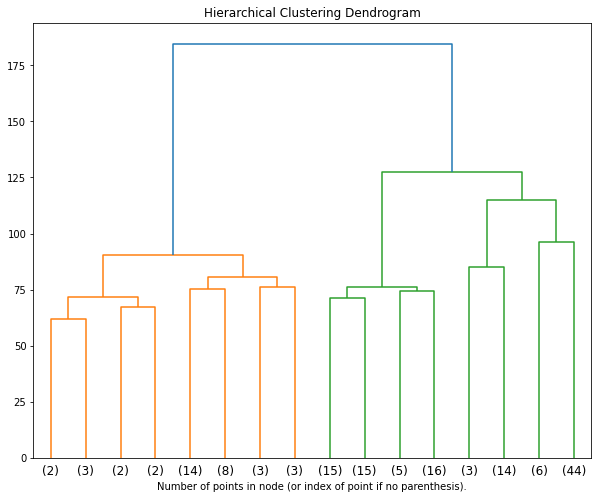

In [64]:
# plot the top three levels of the dendrogram
fig = plt.figure(figsize=(10, 8))
plt.title('Hierarchical Clustering Dendrogram')
plot_dendrogram(data_hclust.named_steps.agglomerativeclustering, 
                truncate_mode='level', 
                p=3)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

[Peer Herholz (he/him)](https://peerherholz.github.io/)  
Research affiliate - [NeuroDataScience lab](https://neurodatascience.github.io/) at [MNI](https://www.mcgill.ca/neuro/)/[McGill](https://www.mcgill.ca/) (& [UNIQUE](https://sites.google.com/view/unique-neuro-ai)) & [Senseable Intelligence Group](https://sensein.group/) at [McGovern Institute for Brain Research](https://mcgovern.mit.edu/)/[MIT](https://www.mit.edu/)  
Member - [BIDS](https://bids-specification.readthedocs.io/en/stable/), [ReproNim](https://www.repronim.org/), [Brainhack](https://brainhack.org/), [Neuromod](https://www.cneuromod.ca/), [OHBM SEA-SIG](https://ohbm-environment.org/) 

<img align="left" src="https://raw.githubusercontent.com/G0RELLA/gorella_mwn/master/lecture/static/Twitter%20social%20icons%20-%20circle%20-%20blue.png" alt="logo" title="Twitter" width="32" height="20" /> <img align="left" src="https://raw.githubusercontent.com/G0RELLA/gorella_mwn/master/lecture/static/GitHub-Mark-120px-plus.png" alt="logo" title="Github" width="30" height="20" />   &nbsp;&nbsp;@peerherholz 

<img align="right" src="https://raw.githubusercontent.com/PeerHerholz/ML-DL_workshop_SynAGE/master/lecture/static/ml-dl_workshop.png" alt="logo" title="Github" width="400" height="280" />